In [ ]:
import matplotlib.pyplot as plt


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


4. Features
Some information about the data:

We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
- There are 120 breeds of dogs (this means there are 120 different classes).
- There are around 10,000+ images in the training set (these images have labels).
- There are around 10,000+ images in the test set (these images have no labels, because we'll want to predict them

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
tf.__version__ , hub.__version__

('2.8.2', '0.12.0')

In [ ]:
print("available" if tf.config.list_physical_devices('GPU') else "not available")

available


Change from the runtime---> change runtime type
- getting data ready

In [ ]:
import pandas as pd
labels_csv=pd.read_csv("/content/drive/MyDrive/Dog_vision/labels.csv")
print(labels_csv.describe())
print(labels_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


No missing values, 10222 unique pics, 120 unique breed. 

In [ ]:
labels_csv["breed"].value_counts()


scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

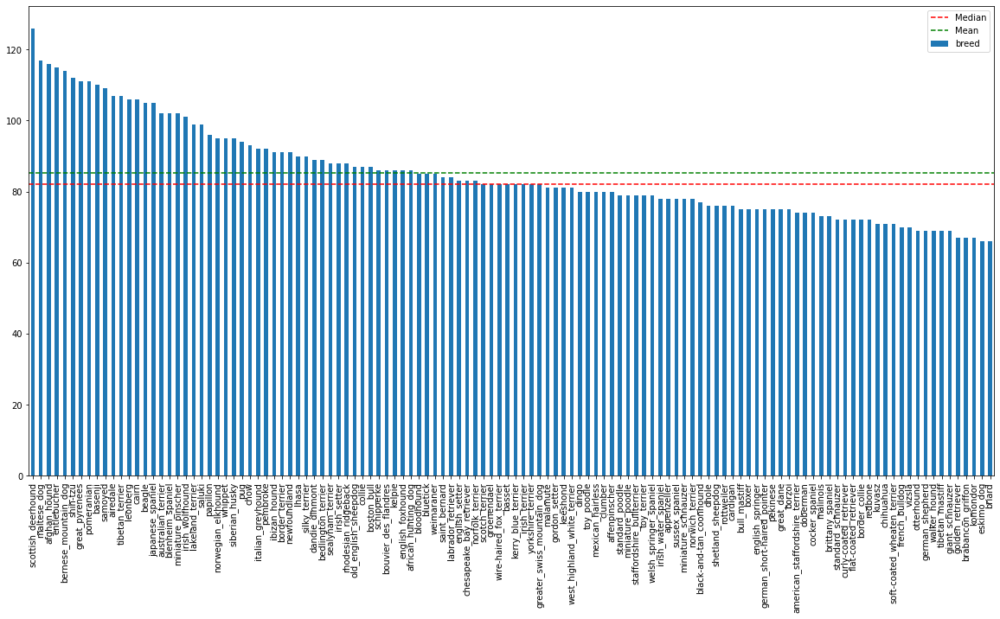

In [ ]:
ax=labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));
ax.axhline(y=labels_csv["breed"].value_counts().median(),c='r',ls='--',label='Median')
ax.axhline(y=labels_csv["breed"].value_counts().mean(),c='g',ls='--',label='Mean');
ax.legend()



View image inside colab

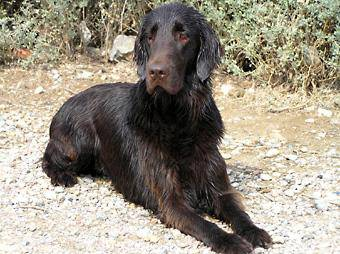

In [ ]:
from IPython.display import Image

Image('/content/drive/MyDrive/Dog_vision/test/06fb0df3d5a54b2f8f4d9295c0c6f4d5.jpg')

### Getting images and their labels
- *Create pathname from image ID*

In [ ]:
filenames=[labels_csv['id']]  #create a list of id
filenames

[0        000bec180eb18c7604dcecc8fe0dba07
 1        001513dfcb2ffafc82cccf4d8bbaba97
 2        001cdf01b096e06d78e9e5112d419397
 3        00214f311d5d2247d5dfe4fe24b2303d
 4        0021f9ceb3235effd7fcde7f7538ed62
                        ...               
 10217    ffd25009d635cfd16e793503ac5edef0
 10218    ffd3f636f7f379c51ba3648a9ff8254f
 10219    ffe2ca6c940cddfee68fa3cc6c63213f
 10220    ffe5f6d8e2bff356e9482a80a6e29aac
 10221    fff43b07992508bc822f33d8ffd902ae
 Name: id, Length: 10222, dtype: object]

In [ ]:
# Create pathnames from image ID's

filenames = ["/content/drive/MyDrive/Dog_vision/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10 filenames
filenames[:10]

['/content/drive/MyDrive/Dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Dog_vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Dog_vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Dog_vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Dog_vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Dog_vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Dog_vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Dog_vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Dog_vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Dog_vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

To make sure we got same amount of filenames.

In [ ]:
import os
len(os.listdir('/content/drive/MyDrive/Dog_vision/train'))==len(filenames)

True

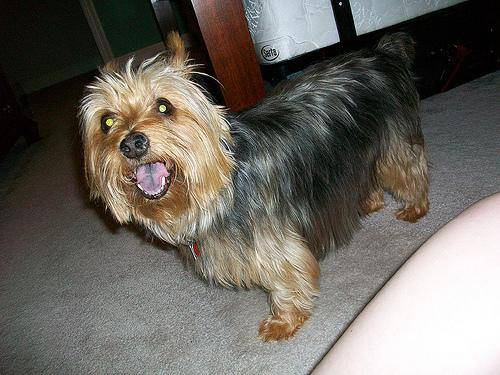

In [ ]:
# Check an image directly from a filepath
Image(filenames[614])

In [ ]:
labels_csv['breed'][614]

'australian_terrier'

In [ ]:
import numpy as np
labels=labels_csv['breed'].to_numpy()
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)==len(filenames)

True

In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
# Example: Turn one label into an array of booleans
print(labels[0])
labels[0] == unique_breeds # use comparison operator to create boolean array

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
boolean_labels=[label==unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

Convert bolleans labels to numbers

In [ ]:
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
labels[0]

'boston_bull'

In [ ]:
labels[0]==unique_breeds

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

### index where unique breed occurs in **`labels array `**


In [ ]:
np.where(labels[0]==unique_breeds)

(array([19]),)

### index where label occurs in 1st element of array of **`boolean_labels`**

In [ ]:
print(boolean_labels[0].argmax()) 

19


In [ ]:
#first elemenr of boolean labels array
boolean_labels[0]

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

### convert list of boolean into integers

In [ ]:
boolean_labels[0].astype(int)

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [ ]:
filenames[:10]

['/content/drive/MyDrive/Dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Dog_vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Dog_vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Dog_vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Dog_vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Dog_vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Dog_vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Dog_vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Dog_vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Dog_vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
X=filenames
y=boolean_labels
#Let's start experimenting with 1000 and increase it as we need.

# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES], 
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
# Check out the training data (image file paths and labels)
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/Dog_vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Dog_vision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Dog_vision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Dog_vision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Dog_vision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         Fals

### Now we preprocess our images. 
Rather than preprocessing now, we preprocess when we need them, cz its easy to manipulate filename rather than image. 
##### **Steps to Preprocess images to tensors**  <br> 
1. Take image filepath as input
2. Use tensorflow to read a file and save it to a variable called `image`
3. Convert `image` to tensors
4. Normalize the image, from size (0,255) to (0,1).
5.Resize the image to standardize size (224,224)
6. Return modified `image`

Before we jump to making a function, lets see how image looks like in tensor

In [ ]:
from matplotlib.pyplot import imread
image=imread(filenames[42])   #filenames is list of file address
image  #the matricx is of color channel

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  53],
        [ 97,  88,  49],
        [120, 111,  72]]

In [ ]:
#converting the array of image into tensor
tf.constant(image)   #which is same as image but this can be read in colab

<tf.Tensor: shape=(257, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  5

In [ ]:
print('color channel is: ', image.shape)
image.max(),image.min()   #since in rgb, range of color coding is from 0 to 255

color channel is:  (257, 350, 3)


(255, 0)

Now lets create the function

In [ ]:
IMG_SIZE=224
def process_image(image_path,img_size=IMG_SIZE):
  '''
  Takes image filpath and turns to tensor
  '''
  image=tf.io.read_file(image_path) #not only fetches from adress but also converts to tensors
  image=tf.image.decode_jpeg(image,channels=3) #converts into 3 color channel
  image=tf.image.convert_image_dtype(image,tf.float32) #Normalize color code: from (0,255) to (0,1), there will change in range of numbers used
  image=tf.image.resize(image,size=[IMG_SIZE,IMG_SIZE])  #resize image to condition,there will be change in matrix shape
  return image


Turning our data into batches
Why turn our data into batches?

Let's say you're trying to process 10,000+ images in one go... they all might not fit into memory.

So that's why we do about 32 (this is the batch size) images at a time (you can manually adjust the batch size if need be).

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this: (image, label).

In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the assosciated label,
  processes the image and reutrns a typle of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# Demo of the above
(process_image(X[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Convert data to tuple of tensors in the form of **`(image,labels)`** <br>
Lets make a function to turn all our data (**`X`** and **`y`**) into batches

In [ ]:
BATCH_SIZE=32 #defining the batch size
def create_data_batches(X,y=None,batch_size=BATCH_SIZE,valid_data=False,test_data=False):
  """
  Create batches of data out of image (X) and labels (y) pairs. 
  Shuffles the data if training data but doesnt shuffles if validiation data.
  Also accepts test data as input. (Here, since no labels, y=None)
  """
  #in test data, no labels.
  if test_data:
    print('Creating test data batches...')
    data=tf.data.Dataset.from_tensor_slices((tf.constant(X)))
    data_batch=data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  #we dont shuffle valid dataset
  elif valid_data:
    print('Creating valid data batches')
    data=tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(y)))
    data_batch=data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch
  else:
    #test_data=false and valid_data=False, so remaining is training
    print('Creating training data batches...')
    data=tf.data.Dataset.from_tensor_slices((tf.constant(X),tf.constant(y)))
    #shuffling pathnames and label befre mapping. Since shuffling images makes it too slow
    data = data.shuffle(buffer_size=len(X))
    data_batch=data.map(get_image_label).batch(BATCH_SIZE)
  return data_batch



Create training and validiation data batches

In [ ]:
train_data=create_data_batches(X_train,y_train)
val_data=create_data_batches(X_val,y_val,valid_data=True)

Creating training data batches...
Creating valid data batches


In [ ]:
train_data.element_spec,val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

#### Visualize data into batches

In [ ]:
def show_25_images(images,labels):
  '''
  Display plot of only 25 images and labels from databatch'''
  plt.figure(figsize=(10,10))
  for i in range(25):
    ax=plt.subplot(5,5,i+1) #(row,columns,index)
    plt.imshow(images[i])
    plt.title(unique_breeds[labels[i].argmax()])
    #plt.axis('off')

In [ ]:
#to see how train_data looks like. Batch of images and labels
train_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

to convert it into iterator >>> train_data.as_numy_iterator() <br>
`next` takes an iterator. But it also returns next item from iterator and unpacks it

In [ ]:
train_images,train_labels=next(train_data.as_numpy_iterator())
train_images,train_labels

(array([[[[1.        , 0.9731369 , 1.        ],
          [1.        , 0.9903712 , 1.        ],
          [1.        , 0.99303436, 0.96959037],
          ...,
          [0.97325593, 0.9922336 , 0.96838903],
          [0.9880905 , 0.9920121 , 0.96729213],
          [0.97888654, 0.9828081 , 0.95143557]],
 
         [[1.        , 0.97496504, 0.99647313],
          [1.        , 0.9908057 , 0.99470973],
          [0.99954   , 0.993361  , 0.9788477 ],
          ...,
          [0.9761268 , 0.99510443, 0.9712599 ],
          [0.9847777 , 0.98869926, 0.9648483 ],
          [0.97602415, 0.9799457 , 0.95429796]],
 
         [[1.        , 0.9809153 , 0.96745455],
          [1.        , 0.99442166, 0.9818876 ],
          [0.9972882 , 0.9968593 , 0.9902487 ],
          ...,
          [0.9774842 , 0.9963936 , 0.9726855 ],
          [0.9837185 , 0.9876401 , 0.9641107 ],
          [0.974965  , 0.97888654, 0.95535713]],
 
         ...,
 
         [[0.9376522 , 0.5941164 , 0.07843655],
          [0.94493

In [ ]:
len(train_images),len(train_labels)

(32, 32)

visualize data in train databatch. (also, each time we run, output changes cz train shuffles data)

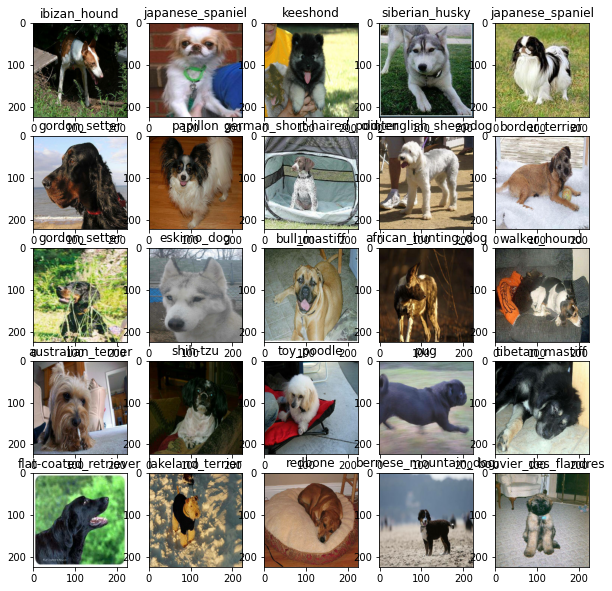

In [ ]:
train_images,train_labels=next(train_data.as_numpy_iterator())
show_25_images(train_images,train_labels)

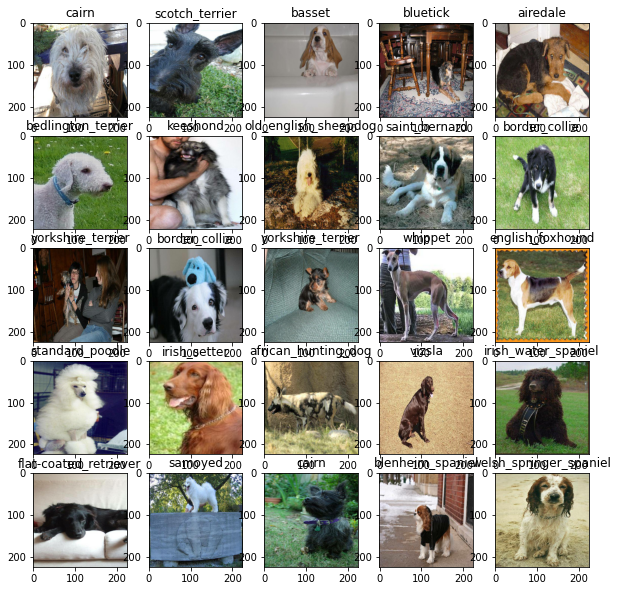

In [ ]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

Building a model
Before we build a model, there are a few things we need to define:

- The input shape (images, in the form of Tensors) to our model.
- The output shape (image labels, in the form of Tensors) of our model.
- The URL of the model we want to use.

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL='https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5'

Many ways to build a model like TF API (sequential and functional API). <br> now we got input,output and model, to put them togather, lets create a function which :
* Take input shape, output shape and model (from URL) as parameters
* define layers in keras model in sequential fashion
* compiles model (says how it should be evaluated and improved)
* builds model (tells model of input shape it will be getting)
* returns model..

In [ ]:
def create_model(input_shape=INPUT_SHAPE,output_shape=OUTPUT_SHAPE,model_url=MODEL_URL):
  print("building model with:  ",model_url)
  #setup the model layer
  model=tf.keras.Sequential([
              hub.KerasLayer(model_url),
              tf.keras.layers.Dense(units=output_shape,
                                    activation='softmax')
  ])
  #Complie the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=['accuracy']
      )
  #build the model
  model.build(input_shape)
  return model
#lets run the model
model=create_model()

building model with:   https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


Callbacks are helper functions a model can use during training to do things such as save a models progress, check a models progress or stop training early if a model stops improving.

The two callbacks we're going to add are a TensorBoard callback and an Early Stopping callback.

TensorBoard Callback
TensorBoard helps provide a visual way to monitor the progress of your model during and after training.

It can be used directly in a notebook to track the performance measures of a model such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:
- Load tensorboard extension
- create tensorboard callback which will save logs to directory and pass models `fit()` function.
- visualize models training logs with %tensorboard magic function after training

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:

import datetime
def create_tensorboard_callback():
  logdir=os.path.join('/content/drive/MyDrive/Dog_vision/logs', #make it so logs get tracked here
                      datetime.datetime.now().strftime('%Y%m%d-%H%M#S'))
  return tf.keras.callbacks.TensorBoard(logdir)

# Create early stopping (once our model stops improving, stop training)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

In [ ]:
NUM_EPOCHS=100 #@param {type:'slider',min:10,max:100,steps:10}


Lets create a function:
- create models using `create_models()`
- setup tensorboard using `create_tensorboard_callback()`
- call `fit()` function on our model,passing it training data, val data, no. of epoch to train and 

In [ ]:
def train_model():
  """train given model and return trained function"""
  model=create_model() 
  tensorboard=create_tensorboard_callback()
  #fit model to data passing it callbacks we created
  model.fit(x=train_data,epochs=NUM_EPOCHS,validation_data=val_data,validation_freq=1,
            callbacks=[tensorboard,early_stopping])
  return model
model=train_model()

building model with:   https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 374s 15s/step - loss: 4.6119 - accuracy: 0.0988 - val_loss: 3.5194 - val_accuracy: 0.2050
Epoch 2/100
25/25 [==============================] - 3s 124ms/step - loss: 1.6387 - accuracy: 0.6925 - val_loss: 2.2117 - val_accuracy: 0.4950
Epoch 3/100
25/25 [==============================] - 4s 152ms/step - loss: 0.5709 - accuracy: 0.9362 - val_loss: 1.7137 - val_accuracy: 0.6000
Epoch 4/100
25/25 [==============================] - 3s 128ms/step - loss: 0.2530 - accuracy: 0.9887 - val_loss: 1.4933 - val_accuracy: 0.6250
Epoch 5/100
25/25 [==============================] - 3s 135ms/step - loss: 0.1476 - accuracy: 0.9962 - val_loss: 1.4147 - val_accuracy: 0.6500
Epoch 6/100
25/25 [==============================] - 6s 247ms/step - loss: 0.1021 - accuracy: 1.0000 - val_loss: 1.3696 - val_accuracy: 0.6550
Epoch 7/100
25/25 [============================

Model is overfitting as its performing too good in train data than validation data<br>




### Checking the TensorBoard logs
Now our model has been trained, we can make its performance visual by checking the TensorBoard logs.

The TensorBoard magic function (%tensorboard) will access the logs directory we created earlier and viualize its contents.

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Dog_vision/logs

<IPython.core.display.Javascript object>

Making and evaluating a predictions using a trained model

In [ ]:
val_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
#make predictions on val data (not used on trained on)
predictions=model.predict(val_data, verbose=1) #verbose be like, when you make predictions, show me your progress
predictions

7/7 [==============================] - 2s 278ms/step


array([[4.86836536e-03, 6.28381313e-05, 1.70981314e-03, ...,
        5.66222100e-03, 2.65290320e-04, 4.83545382e-03],
       [1.11196330e-03, 1.27769785e-03, 1.39562925e-02, ...,
        1.79427210e-03, 2.00167322e-03, 3.12770862e-04],
       [1.47117617e-05, 2.89607651e-05, 1.81583728e-05, ...,
        5.70015982e-05, 6.88414948e-05, 4.80533854e-05],
       ...,
       [5.24152210e-06, 7.92515348e-05, 1.25395218e-05, ...,
        8.70791064e-06, 2.11468578e-05, 1.23937753e-05],
       [9.45140782e-04, 4.03255050e-04, 4.61685595e-05, ...,
        7.54584384e-04, 7.01544850e-05, 3.96448094e-03],
       [3.45427281e-04, 5.71552046e-05, 2.68638856e-03, ...,
        1.82613952e-03, 3.87120206e-04, 9.04320113e-05]], dtype=float32)

In [ ]:
predictions.shape , len(y_val)

((200, 120), 200)

In [ ]:
predictions[0]   #this is probability for likliness for first image

array([4.86836536e-03, 6.28381313e-05, 1.70981314e-03, 5.67691895e-05,
       7.00534147e-04, 5.29925237e-05, 3.41014937e-02, 9.11278301e-04,
       1.12118440e-04, 9.82754864e-04, 3.16593284e-03, 7.63679855e-05,
       1.43559359e-04, 1.98745198e-04, 1.86906575e-04, 3.67862958e-04,
       1.21459569e-04, 2.28242785e-01, 3.18696038e-05, 1.30391621e-04,
       4.35905851e-04, 7.31317705e-05, 9.20918101e-05, 2.68080435e-03,
       4.57279602e-05, 2.83237954e-04, 1.44327566e-01, 2.06963174e-04,
       6.18124555e-04, 5.64426475e-04, 2.96877261e-04, 4.84240148e-03,
       1.52661710e-03, 1.93435008e-05, 5.41095433e-05, 3.79785872e-03,
       1.92111256e-04, 5.18066576e-04, 3.87990804e-05, 7.90383347e-05,
       8.14113009e-04, 1.36597191e-05, 1.79290029e-04, 9.86528830e-05,
       5.98741062e-05, 2.75533948e-05, 9.69383836e-05, 6.51702052e-04,
       2.37904052e-04, 1.05192717e-04, 3.28049238e-04, 2.47102016e-05,
       1.24423532e-04, 1.68017097e-04, 1.56293376e-04, 7.60463954e-05,
      

In [ ]:
np.sum(predictions[1]),np.sum(predictions[6]) #softmax made it close to 1

(1.0, 1.0)

In [ ]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[4.86836536e-03 6.28381313e-05 1.70981314e-03 5.67691895e-05
 7.00534147e-04 5.29925237e-05 3.41014937e-02 9.11278301e-04
 1.12118440e-04 9.82754864e-04 3.16593284e-03 7.63679855e-05
 1.43559359e-04 1.98745198e-04 1.86906575e-04 3.67862958e-04
 1.21459569e-04 2.28242785e-01 3.18696038e-05 1.30391621e-04
 4.35905851e-04 7.31317705e-05 9.20918101e-05 2.68080435e-03
 4.57279602e-05 2.83237954e-04 1.44327566e-01 2.06963174e-04
 6.18124555e-04 5.64426475e-04 2.96877261e-04 4.84240148e-03
 1.52661710e-03 1.93435008e-05 5.41095433e-05 3.79785872e-03
 1.92111256e-04 5.18066576e-04 3.87990804e-05 7.90383347e-05
 8.14113009e-04 1.36597191e-05 1.79290029e-04 9.86528830e-05
 5.98741062e-05 2.75533948e-05 9.69383836e-05 6.51702052e-04
 2.37904052e-04 1.05192717e-04 3.28049238e-04 2.47102016e-05
 1.24423532e-04 1.68017097e-04 1.56293376e-04 7.60463954e-05
 4.11963003e-04 4.52805310e-03 7.01342942e-05 5.86298928e-02
 1.30325294e-04 7.20577300e-05 1.70081318e-03 7.11674438e-05
 5.90163749e-04 3.470300

In [ ]:
unique_breeds[17]

'border_terrier'

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

Note: Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'border_terrier'

the model hasn't trained on the validation data, during the fit() function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (val_data) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using unbatch()) and then turn it into an iterator using as_numpy_iterator().

Let's make a small function to do so.

In [ ]:
# Create a function to unbatch a batched dataset
for image, label in val_data.unbatch().as_numpy_iterator():
  print(image)
  print(label)

Streaming output truncated to the last 5000 lines.

 [[0.25513488 0.2201559  0.19254734]
  [0.25818455 0.22320555 0.19559701]
  [0.28897902 0.25400004 0.22639151]
  ...
  [0.1393125  0.11606315 0.06900432]
  [0.12893534 0.11324906 0.06619024]
  [0.1432429  0.12755662 0.08441938]]

 ...

 [[0.33103618 0.4942971  0.192543  ]
  [0.33433145 0.47802895 0.20559186]
  [0.30533677 0.42943236 0.1872521 ]
  ...
  [0.46766642 0.56528556 0.3105236 ]
  [0.46012917 0.5464037  0.29220206]
  [0.43060845 0.51802564 0.25969562]]

 [[0.23758022 0.4042234  0.09904134]
  [0.29779172 0.44837025 0.16837995]
  [0.34401998 0.46993038 0.22217125]
  ...
  [0.4661402  0.56106675 0.314582  ]
  [0.47245407 0.5587286  0.3078179 ]
  [0.44306177 0.5293363  0.27553126]]

 [[0.2004445  0.37246928 0.06589444]
  [0.26245335 0.41708085 0.13304158]
  [0.34722233 0.47338593 0.21853644]
  ...
  [0.43430075 0.52813834 0.28500107]
  [0.4386964  0.5249709  0.2753912 ]
  [0.43219256 0.51846707 0.26725814]]]
[False False False Fal

In [ ]:
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and reutrns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get get:

Prediction labels
Validation labels (truth labels)
Validation images
Let's make some function to make these all a bit more visaulize.

We'll create a function which:

Takes an array of prediction probabilities, an array of truth labels and an array of images and an integer. ✅
Convert the prediction probabilities to a predicted label. ✅
Plot the predicted label, its predicted probability, the truth label and the target image on a single plot. ✅

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"
  
  # Change plot title to be predicted, probability of prediction and truth label
  plt.title("{} {:2.0f}% {}".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)

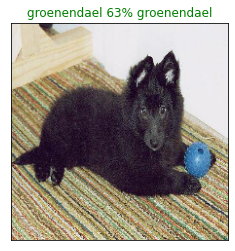

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=77)

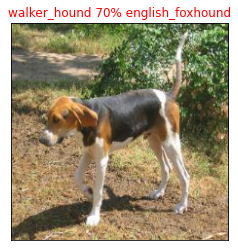

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=42)

Now we've got one function to visualize our models top prediction, let's make another to view our models top 10 predictions.

This function will:

- Take an input of prediction probabilities array and a ground truth array and an integer ✅
- Find the prediction using get_pred_label() ✅
- Find the top 10:
 - Prediction probabilities indexes ✅
 - Prediction probabilities values ✅
 - Prediction labels ✅
- Plot the top 10 prediction probability values and labels, coloring the true label green ✅

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

In [ ]:
unique_breeds[2]

'african_hunting_dog'

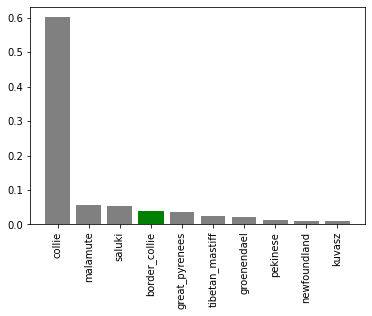

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Now we've got some function to help us visualize our predictions and evaluate our modle, let's check out a few.

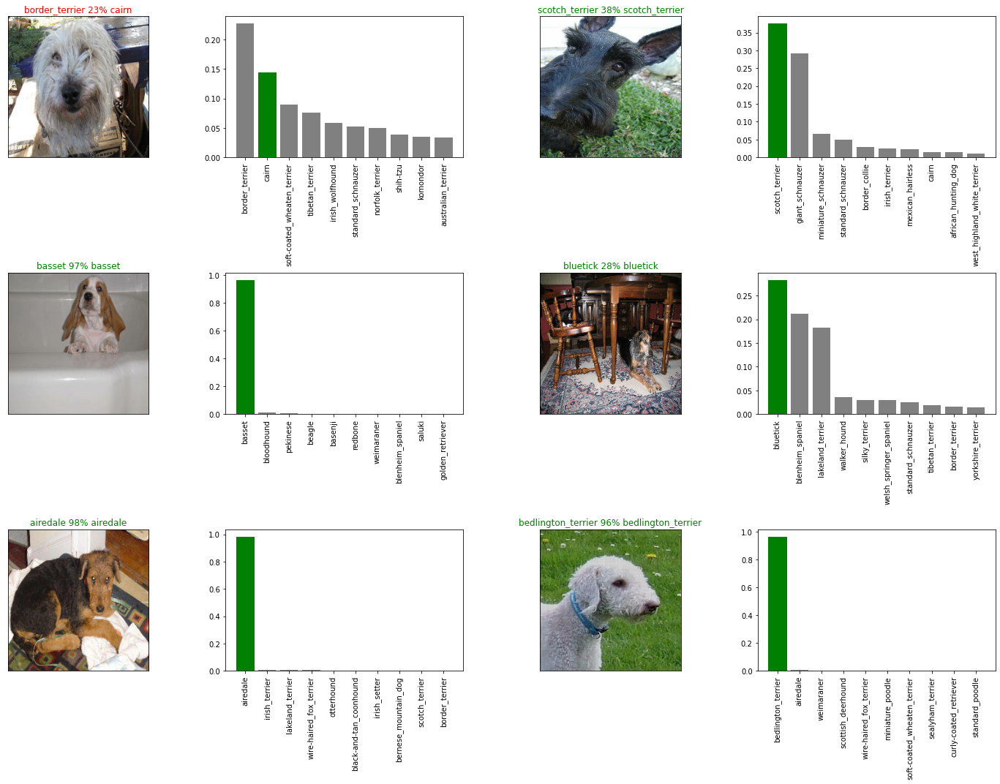

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

Saving and reloading a trained model

In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/Dog_vision/Models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, 
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: /content/drive/MyDrive/Dog_vision/Models/20220901-05271662010077-1000-images-mobilenetv2-Adam.h5...


'/content/drive/MyDrive/Dog_vision/Models/20220901-05271662010077-1000-images-mobilenetv2-Adam.h5'

In [ ]:
# Load a trained model
loaded_1000_image_model = load_model('/content/drive/MyDrive/Dog_vision/Models/20220720-19011658343689-1000-images-mobilenetv2-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Dog_vision/Models/20220720-19011658343689-1000-images-mobilenetv2-Adam.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 84ms/step - loss: 1.2206 - accuracy: 0.6750


[1.220645785331726, 0.675000011920929]

In [ ]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 1s 84ms/step - loss: 1.2752 - accuracy: 0.6400


[1.2752395868301392, 0.6399999856948853]

Training a big dog model 🐶 (on the full data)

In [ ]:
len(X), len(y)

(10222, 10222)

In [ ]:
# Create a data batch with the full data set
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [ ]:
# Create a model for full model
full_model = create_model()

building model with:   https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [ ]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

Note: Running the cell below will take a little while (maybe up to 30 minutes for the first epoch) because the GPU we're using in the runtime has to load all of the images into memory.

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/Dog_vision/logs
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])


Reusing TensorBoard on port 6006 (pid 648), started 0:00:16 ago. (Use '!kill 648' to kill it.)

<IPython.core.display.Javascript object>

Epoch 1/100
320/320 [==============================] - 3669s 11s/step - loss: 1.3515 - accuracy: 0.6702
Epoch 2/100
320/320 [==============================] - 36s 112ms/step - loss: 0.4067 - accuracy: 0.8767
Epoch 3/100
320/320 [==============================] - 36s 113ms/step - loss: 0.2418 - accuracy: 0.9334
Epoch 4/100
320/320 [==============================] - 37s 115ms/step - loss: 0.1567 - accuracy: 0.9617
Epoch 5/100
320/320 [==============================] - 36s 111ms/step - loss: 0.1075 - accuracy: 0.9778
Epoch 6/100
320/320 [==============================] - 35s 110ms/step - loss: 0.0770 - accuracy: 0.9868
Epoch 7/100
320/320 [==============================] - 37s 117ms/step - loss: 0.0589 - accuracy: 0.9915
Epoch 8/100
320/320 [==============================] - 44s 138ms/step - loss: 0.0455 - accuracy: 0.9952
Epoch 9/100
320/320 [==============================] - 39s 123ms/step - loss: 0.0373 - accuracy: 0.9957
Epoch 10/100
320/320 [==============================] - 39s 121m

In [ ]:
save_model(full_model, suffix="all-images-Adam")



Saving model to: /content/drive/MyDrive/Dog_vision/Models/20220901-06471662014822-all-images-Adam.h5...


'/content/drive/MyDrive/Dog_vision/Models/20220901-06471662014822-all-images-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model( "/content/drive/MyDrive/Dog_vision/Models/20220901-06471662014822-all-images-Adam.h5")  ###############################################################################

Loading saved model from: /content/drive/MyDrive/Dog_vision/Models/20220901-06471662014822-all-images-Adam.h5


In [ ]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "/content/drive/MyDrive/Dog_vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['/content/drive/MyDrive/Dog_vision/test/e35b90290702042d17ceee2aaf2d1475.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e5ba665e01b6927411d60158f28160dd.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e6a0eeb3e82e14eb812d9ef22383ec11.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e1dd78810048dc387573f2ec50e4bb16.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e66a91249a4979a86db48e5c64b81a88.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e6e8ae7dc0e71c6ae868fd3371fde010.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e292584f17fa7cea7f95bdadecde0ebb.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e18db768bc1a9e7e633940dcadacb231.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e13f3871a8b4a745717ba6903f0dfe05.jpg',
 '/content/drive/MyDrive/Dog_vision/test/e6da14858db7781843db6af91551f627.jpg']

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)
test_predictions[:10]

Creating test data batches...
324/324 [==============================] - 225s 650ms/step


array([[1.1176535e-07, 1.2544964e-10, 8.8073264e-08, ..., 3.0260118e-08,
        7.2818644e-08, 9.7461079e-06],
       [2.4835234e-10, 4.3129947e-10, 9.9958628e-01, ..., 1.1408262e-10,
        1.2173050e-09, 5.1516486e-11],
       [1.4980452e-08, 1.5220560e-09, 1.1161648e-09, ..., 5.7519278e-10,
        8.0339044e-07, 2.3435827e-07],
       ...,
       [1.7799099e-08, 1.0992281e-06, 1.2119966e-10, ..., 2.0164993e-07,
        1.1122448e-08, 2.5125098e-07],
       [5.2429483e-10, 1.9312413e-06, 2.3167810e-09, ..., 3.2625834e-05,
        7.5596120e-07, 2.6355680e-12],
       [2.8465780e-05, 2.1303576e-04, 4.3995856e-06, ..., 1.5520549e-05,
        1.2360518e-09, 1.3967120e-08]], dtype=float32)

Preparing test dataset predictions for Kaggle
Looking at the Kaggle sample submission, it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:

- Create a pandas DataFrame with an ID column as well as a column for each dog breed.
- Add data to the ID column by extracting the test image ID's from their filepaths.
- Add data (the prediction probabilities) to each of the dog breed columns using the unique_breeds list and the test_predictions list.
- Export the DataFrame as a CSV to submit it to Kaggle.


In [ ]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image ID's to predictions DataFrame
test_path = "/content/drive/MyDrive/Dog_vision/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e35b90290702042d17ceee2aaf2d1475,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,e5ba665e01b6927411d60158f28160dd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e6a0eeb3e82e14eb812d9ef22383ec11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,e1dd78810048dc387573f2ec50e4bb16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e66a91249a4979a86db48e5c64b81a88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()


,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e35b90290702042d17ceee2aaf2d1475,1.117654e-07,1.254496e-10,8.807326e-08,3.743945e-08,2.818457e-07,1.149428e-11,2.652930e-05,3.757187e-08,7.704719e-08,...,1.833489e-07,1.877785e-06,9.902805e-10,1.937855e-09,1.015763e-11,2.040156e-09,7.037645e-05,3.026012e-08,7.281864e-08,9.746108e-06
1,e5ba665e01b6927411d60158f28160dd,2.483523e-10,4.312995e-10,9.995863e-01,2.109383e-11,1.774471e-10,4.044528e-13,7.725963e-07,5.989976e-10,1.948117e-10,...,8.379906e-09,6.024735e-08,1.917625e-10,2.012635e-13,1.556220e-10,1.086495e-10,4.074445e-10,1.140826e-10,1.217305e-09,5.151649e-11
2,e6a0eeb3e82e14eb812d9ef22383ec11,1.498045e-08,1.522056e-09,1.116165e-09,1.443455e-10,1.894371e-08,1.510208e-09,4.310292e-08,4.604027e-08,1.820648e-09,...,2.543960e-01,3.739376e-06,4.271261e-07,1.706216e-09,4.120887e-08,1.749325e-09,1.036601e-06,5.751928e-10,8.033904e-07,2.343583e-07
3,e1dd78810048dc387573f2ec50e4bb16,1.751934e-05,4.946267e-08,2.340982e-09,1.549233e-11,5.920536e-09,2.099820e-09,1.774060e-07,3.316048e-10,2.229069e-07,...,8.714498e-04,8.171937e-07,2.316341e-07,3.529735e-09,8.824451e-09,2.012261e-12,1.703882e-07,2.002911e-08,1.628001e-06,1.764344e-06
4,e66a91249a4979a86db48e5c64b81a88,9.848680e-10,1.468332e-08,4.572443e-13,4.765876e-16,6.604175e-14,1.006294e-10,6.339609e-12,1.182477e-13,1.161819e-15,...,3.843721e-13,2.516878e-09,1.886569e-12,2.226647e-09,2.981623e-13,4.034354e-12,6.948516e-12,2.355575e-08,3.335799e-08,3.937630e-12


In [ ]:
preds_df.to_csv("/content/drive/MyDrive/Dog_vision/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

Making predictions on custom images
It's great being able to make predictions on a test dataset already provided for us.

But how could we use our model on our own images?

The premise remains, if we want to make predictions on our own custom images, we have to pass them to the model in the same format the model was trained on.

To do so, we'll:

- Get the filepaths of our own images.
- Turn the filepaths into data batches using create_data_batches(). And since our custom images won't have labels, we set the test_data parameter to True.
- Pass the custom image data batch to our model's predict() method.
- Convert the prediction output probabilities to prediction labels.
- Compare the predicted labels to the custom images.
##Note:
 To make predictions on custom images, I've uploaded pictures of my own to a directory located at drive/My Drive/Data/dogs/ (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [ ]:
# Get custom image filepaths
custom_path = "/content/drive/MyDrive/Dog_vision/my-dog-photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
custom_image_paths

['/content/drive/MyDrive/Dog_vision/my-dog-photos/kiran.jpg',
 '/content/drive/MyDrive/Dog_vision/my-dog-photos/me.jpg']

In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [ ]:
custom_data

<BatchDataset element_spec=TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None)>

In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

In [ ]:
custom_preds.shape

(2, 120)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['maltese_dog', 'rottweiler']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

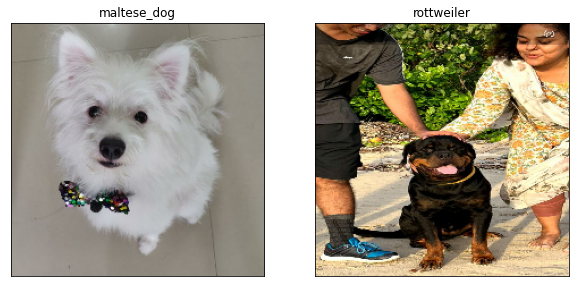

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 2, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)